# ΤΕΧΝΟΛΟΓΙΑ ΚΑΙ ΑΝΑΛΥΣΗ ΕΙΚΟΝΩΝ ΚΑΙ ΒΙΝΤΕΟ


*   ΕΙΡΗΝΗ ΔΟΝΤΗ - 03119839


# 1. Θεωρητικό μέρος

α) Η τιμή της παραμέτρου α επηρεάζει το σχήμα της ισοδύναμης συνάρτησης στάθμισης. Συγκεκριμένα, για α = 0.4 οι ισοδύναμες συναρτήσεις στάθμισης είναι όμοιες με Gaussian, για α = 0.5 είναι όμοιες με τρίγωνο, για α = 0.3 είναι όμοιες με ευρύτερο και επίπεδο Gaussian και για α = 0.6 ο κεντρικό λοβός είναι απότομα κατακόρυφος και πλαισιώνεται από μικρούς αρνητικούς λοβούς. Το σχήμα της ισοδύναμης συνάρτησης στάθμισης, επηρεάζει τον όγκο των πληροφοριών που περιλαμβάνονται σε κάθε επίπεδο της Gaussian Πυραμίδας και συνεπώς επηρεάζει τον βαθμό εξομάλυνσης, το πλάτος της ισοδύναμης συνάρτησης στάθμισης και την ανάλυση της πυραμίδας. Τα επίπεδα της πυραμίδας φαίνονται πιο "crisper" όταν δημιουργούνται με μεγάλες τιμές του α, παρά με μικρότερες τιμές στις οποίες οι ισοδύναμες συναρτήσεις στάθμισης πλησιάζουν την Gaussian συνάρτηση.

β) Εντροπία είναι το μέτρο του αβέβαιου περιεχομένου μίας πληροφορίας και περιγράφει τη συχνότητα μίας πληροφορίας σε μία ακολουθία πληροφορίας.
Η μέγιστη τιμή εντροπίας που μπορεί να έχει μία grayscale εικόνα 8-bit, δηλαδή με 256 διαφορετικά επίπεδα φωτεινότητας είναι Η = -Σ(1/256)log2(1/256) ≈ 8. 

γ) Το εύρος τιμών των εικονοστοιχείων χωρίζεται σε bin μεγέθους n. Οπότε, όσο μεγαλύτερη είναι η τιμή n, τόσο το κβαντισμένο σήμα θα έχει λιγότερο πλήθος bin και συνεπώς χειρότερη ανάλυση (χονδρικά κβαντισμένα).  

δ) Η πυραμίδα επιπέδων είναι μία ιεραρχία εικόνων που παράγεται από την αρχική εικόνα, από την οποία κάθε επίπεδο αποτελείται από μία εκδοχή της αρχικής εικόνας με διαφορετικό επίπεδο ανάλυσης. Μία πυραμίδα λίγων επιπέδων σημαίνει ότι η αρχική εικόνα θα υποβληθεί σε λιγότερες διαδικασίες κβαντισμού και συνεπώς να μειωθεί η ποιότητα της εικόνας παρέχοντας λιγότερο λεπτομερή αναπαράσταση της αρχικής εικόνας.

# 2. Εργαστηριακό μέρος

# *Α.Υλοποίηση αλγορίθμου*

In [1]:
import urllib.request
import cv2 
import numpy as np
from matplotlib import pyplot as plt
from array import *
import scipy.ndimage as ndi
import scipy.stats as st
from scipy import signal
from scipy.fftpack import fft2,fftshift,ifftshift,ifft2
import statistics
from skimage import color, data, img_as_float,img_as_ubyte
from scipy.stats import entropy as sp_ent

%matplotlib inline

#a
# Create Ganerate Kernel function depending on parameter a
def GKernel(a): 
    b = 1/4
    c = 1/4 - a/2
    kernel = np.array([[c], [b], [a], [b], [c]])
    h = kernel @ kernel.T
    return h

#b
# Create GREDUCE function depending on parameters I and h
def GREDUCE(I,h): 
    I_out = cv2.filter2D(I, -1, h)
    I_out = cv2.resize(I_out, (I_out.shape[1]//2, I_out.shape[0]//2), interpolation=cv2.INTER_AREA)
    return I_out

#c
# Create GPyramid function depending on parameters I, a and depth
def GPyramid(I, a, depth):
  G = [I] # Base of pyramid
  aux = I
  h = GKernel(a)
  for i in range(depth-1):
    aux = GREDUCE(aux, h)
    G.append(aux)
  return G

#d
# Create GEXPAND function depending on parameters I and h - Reverse of GREDUCE
def GEXPAND(I,h):
  I_out = cv2.resize(I, (I.shape[1]*2, I.shape[0]*2), interpolation=cv2.INTER_AREA)
  I_out = cv2.filter2D(I_out,-1,h)
  return I_out

#e
# Create LPyramid function depending on parameters I, a and depth
def LPyramid(I,a,depth):
  h = GKernel(a)
  G = GPyramid(I, a, depth)
  L = [G[depth-1]]
  for n in range(depth-1):
    dif = G[depth-n-2] - GEXPAND(G[depth-n-1],h) + 128
    L.append(dif)
  L.reverse()
  return L

#f
# Create L_Pyramid_Decode function depending on parameters L and a
def L_Pyramid_Decode(L,a):
  h = GKernel(a)
  N = len(L)
  I_out = L[N-1]
  for n in range(N-1):
    I_out = GEXPAND(I_out,h)
    I_out = I_out + L[N-n-2] - 128
  return I_out

#g
# Create L_Quantization function depending on parameters I and bins
def L_Quantization(I,bins):
  quantization = np.linspace(0,255,num=bins) # create bins for 256 pixel values
  r = np.roll(quantization,-1)
  r[-1] = 255 # final bin value is 2*255
  LQ = (np.digitize(I,quantization)+np.digitize(I,r))//2
  return LQ.astype(np.uint8)


# *Β. Δοκιμές αλγορίθμου*

  ΕΡΩΤΗΜΑ Α

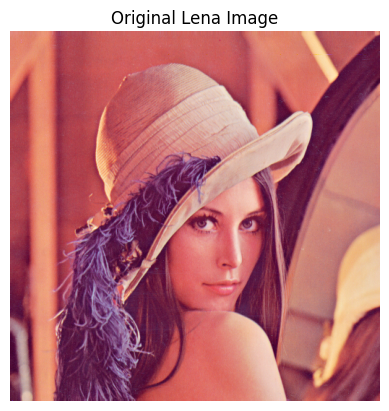

In [2]:
#a

# Load Lena Image

HTTP_response = urllib.request.urlopen('http://www.image.ntua.gr/~tpar/LABimage/lena.png')
arr = np.asarray(bytearray(HTTP_response.read()), dtype=np.uint8)
Lena_BGR = cv2.imdecode(arr,-1)
Lena_RGB = cv2.cvtColor(Lena_BGR, cv2.COLOR_BGR2RGB)
Lena_R = Lena_RGB[:,:,0]
Lena_G = Lena_RGB[:,:,1]
Lena_B = Lena_RGB[:,:,2]
plt.title('Original Lena Image')
plt.imshow(Lena_RGB)
_ = plt.axis('off')


In [3]:
# Auxiliary function to print multiple images

def print_images(images, title, color):
    if color != 'gray':
        color = 'viridis'
    length = len(images)
    ax = np.zeros(length)
    f, ax = plt.subplots(1, length, figsize=(25, 25))
    for i in range(length):
        ax[i].imshow(images[i], cmap=color) 
        ax[i].set_title(title[i], fontsize=14)
    return


In [4]:
# Auxiliary function to check channel loss

def channel_loss_check(im, c, a, depth):

  #Original Image
  plt.figure()
  if c != 'gray':
      plt.title('Original Image - Channel '+c)
      plt.imshow(im)
  else:
      plt.title('Original Grayscale Image')
      plt.imshow(im, cmap='gray')

  #Laplacian Pyramid
  LP = LPyramid(im,a,depth)
  DecodeLP = L_Pyramid_Decode(LP,a)
  t = ['Laplacian Pyramid of Channel '+c+'['+str(i)+']' for i in range(depth)]
  print_images(LP, t, c)

  #Decoded Image
  plt.figure()
  if c != 'gray':
      plt.title('Decoded Original Image - Channel '+c)
      plt.imshow(DecodeLP)
  else:
      plt.title('Decoded Original Grayscale Image')
      plt.imshow(DecodeLP, cmap='gray')
  
  #Check if there is loss during procedure
  if(DecodeLP == im).all():
    print('There is no loss during image procedure')
  return DecodeLP

There is no loss during image procedure


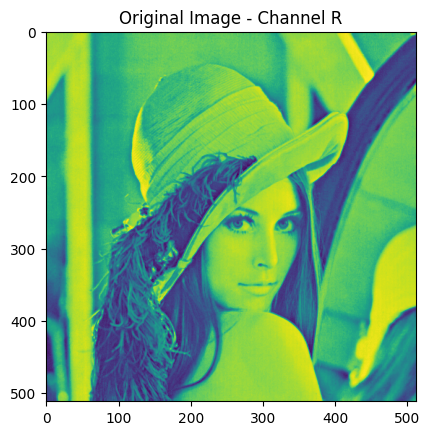

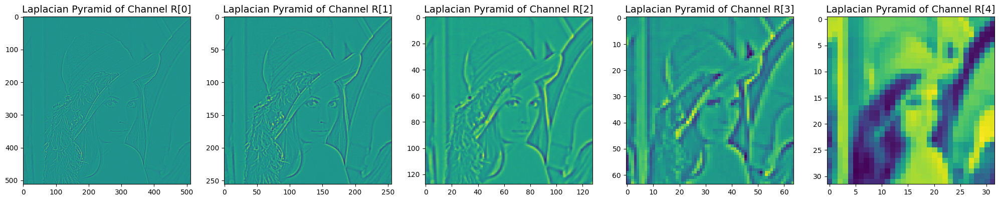

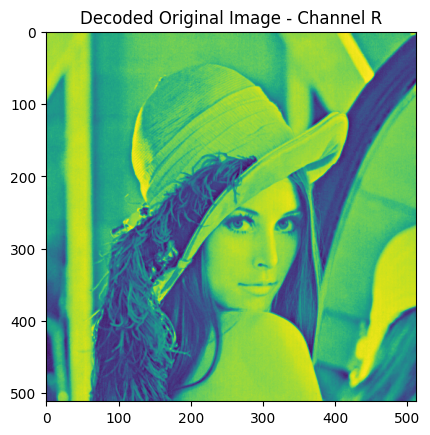

In [5]:
decode_img_R = channel_loss_check(Lena_R,'R', 0.5, 5)

There is no loss during image procedure


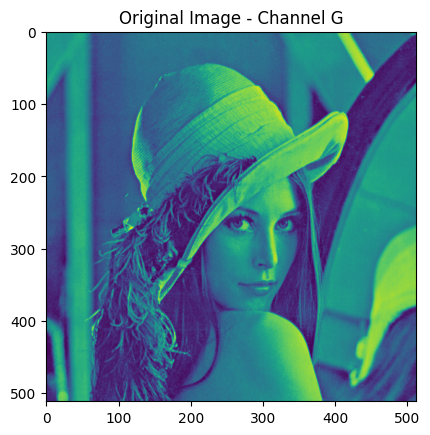

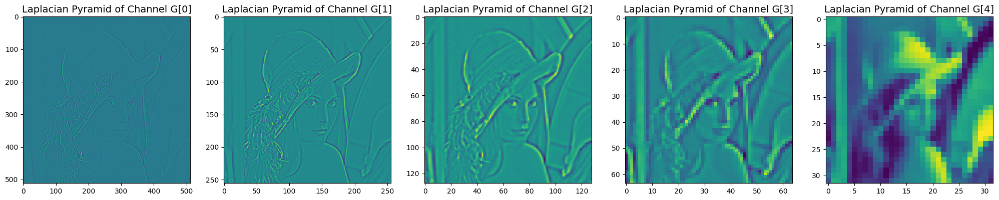

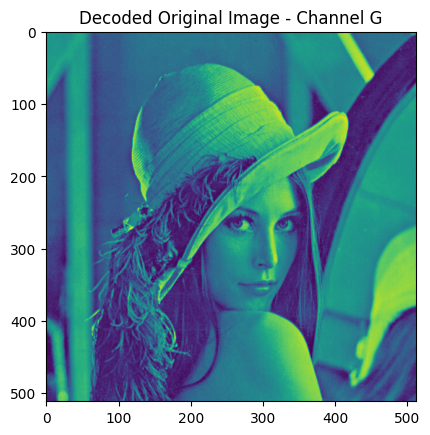

In [6]:
decode_img_G = channel_loss_check(Lena_G,'G', 0.5, 5)

There is no loss during image procedure


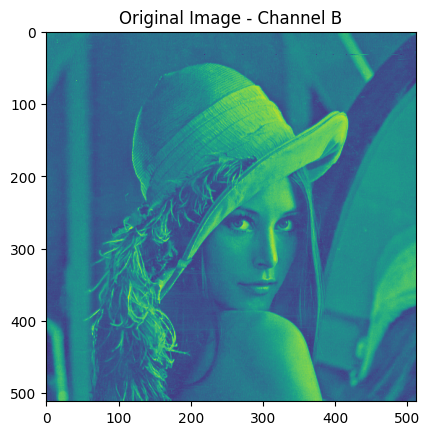

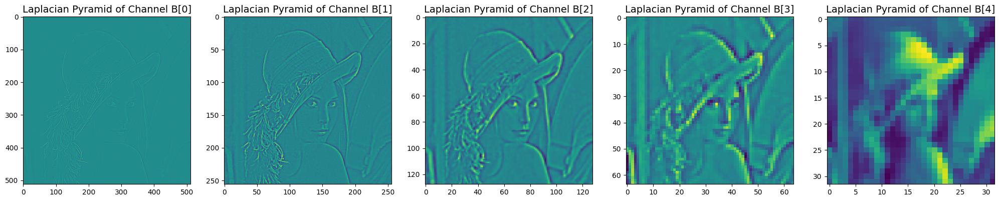

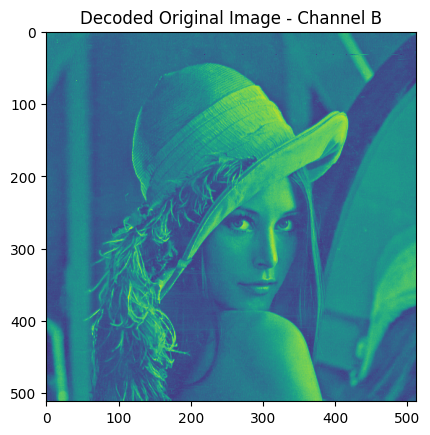

In [7]:
decode_img_B = channel_loss_check(Lena_B,'B', 0.5, 5)

There is no loss during image procedure


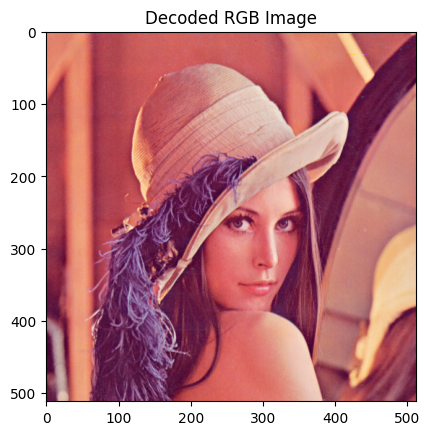

In [8]:
# Merge Channels
merge = cv2.merge((decode_img_R, decode_img_G, decode_img_B))
plt.imshow(merge)
plt.title('Decoded RGB Image')

if (merge == Lena_RGB).all():
    print('There is no loss during image procedure')

There is no loss during image procedure


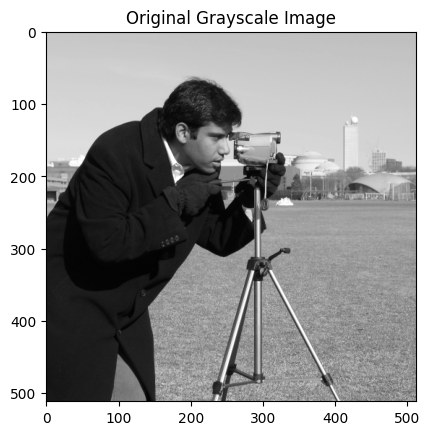

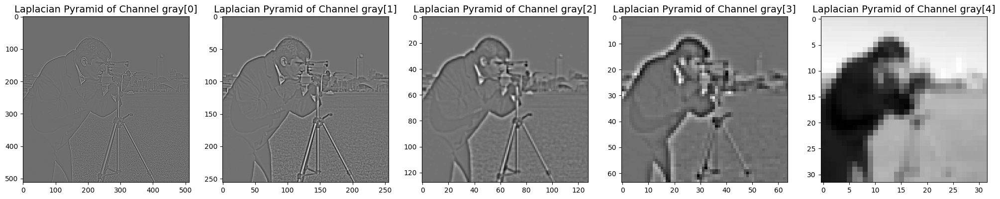

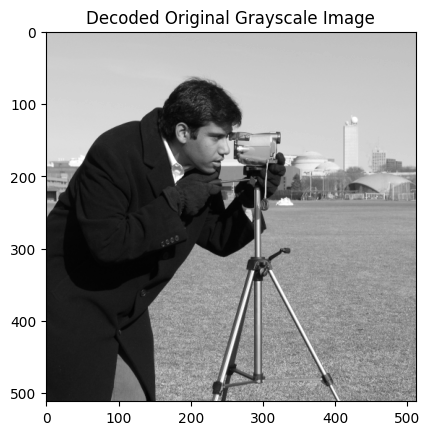

In [9]:
# Load camera Image

camera = data.camera()
cameraDecode = channel_loss_check(camera, 'gray', 0.5, 5)

**Σχολιασμός Αποτελεσμάτων:**

Παρατηρούμε ότι οι εικόνες ανακατασκευάζονται με ακρίβεια με τη βοήθεια της Laplacian Pyramid (με ίδια παράμετρο α). Κάθε επίπεδο της Laplacian Pyramid είναι μία πιο "smoothed" έκδοση του προηγούμενού του, το οποίο είναι λογικό καθώς αποτελεί ένα βαθυπερατό τμήμα του προηγούμενου επιπέδου και συνεπώς, στα χαμηλότερα επίπεδα, οι εικόνες είναι πιο λεπτομερείς. Όσο προχωράμε στα επόμενα επίπεδα, η εικόνα γίνεται λιγότερο "crisper". 

ΕΡΩΤΗΜΑ Β

In [10]:
#b
def matching_test(img, channel, a, depth, mode):
    L = img

    # Laplacian Pyramid
    LPT = LPyramid(L, a, depth)
    decoded = L_Pyramid_Decode(LPT, a)
    if mode == 'a':
        title = ['a = '+str(a) for i in range(depth)]
    else:
        title = ['depth = '+str(depth) for i in range(depth)]  
    print_images(LPT, title, channel)

    # check 
    if (decoded == img).all():
      if mode == 'a':
        print('a = '+str(a)+': Decoded and original image -> matching completely')
      else:
        print('depth = '+str(depth)+': Decoded and original image -> matching completely')

    return (decoded, LPT)


In [11]:
a = np.arange(0.3,0.8,0.1) 

a = 0.3: Decoded and original image -> matching completely
a = 0.4: Decoded and original image -> matching completely
a = 0.5: Decoded and original image -> matching completely
a = 0.6: Decoded and original image -> matching completely
a = 0.7: Decoded and original image -> matching completely


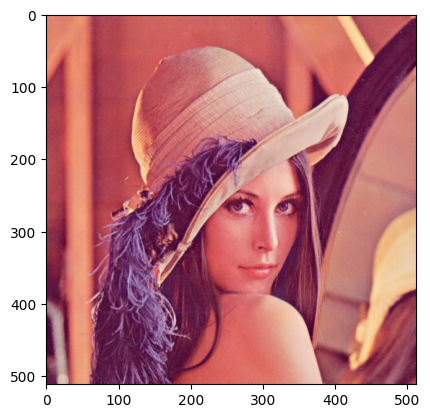

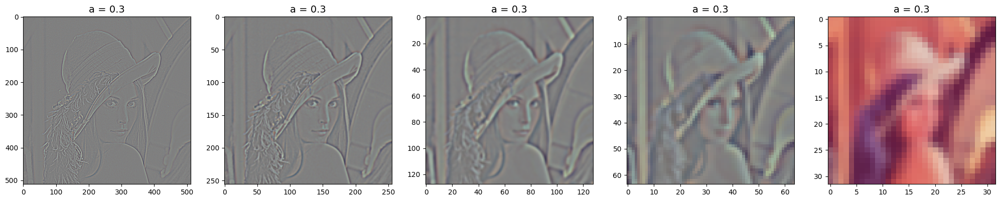

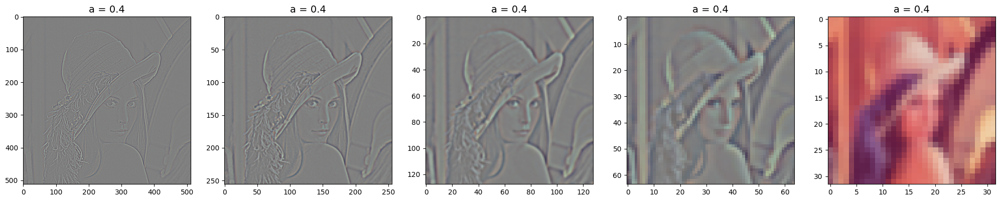

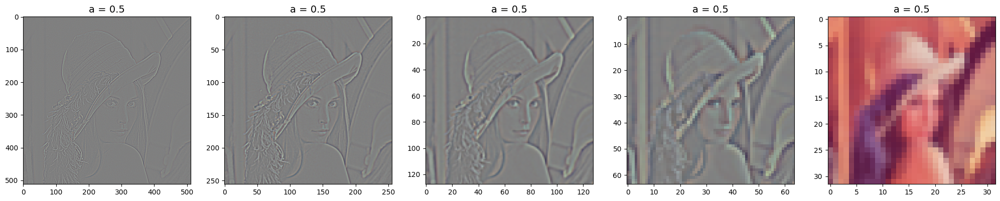

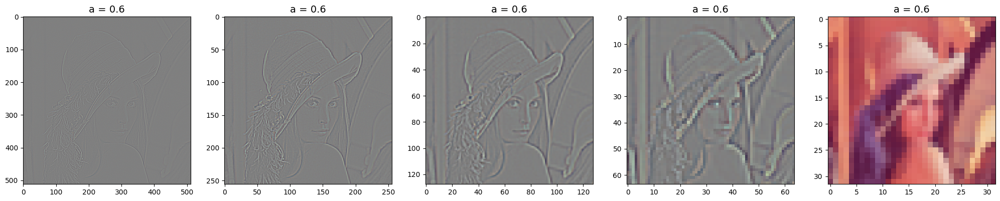

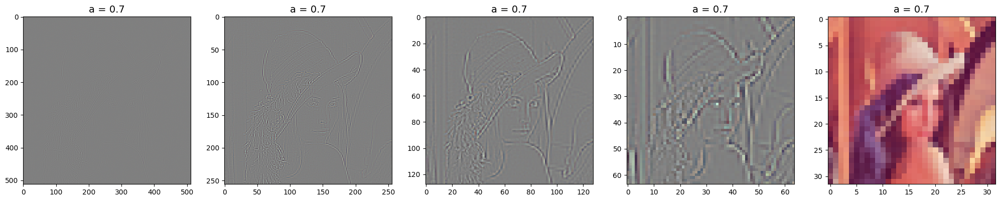

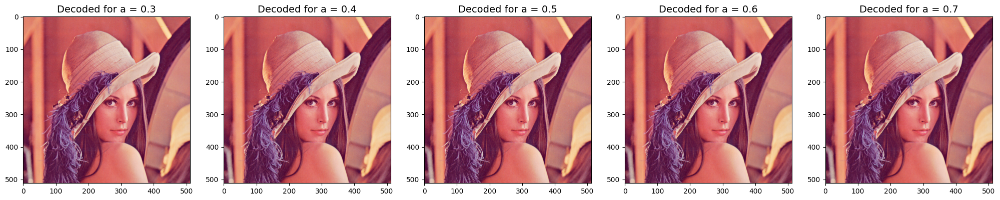

In [12]:
L_tester_a = []
Lena_tester_a = []
plt.imshow(Lena_RGB)

for i in a:
    decoded, LPT = matching_test(Lena_RGB, 'color', round(i,1), 5, 'a')
    L_tester_a.append(decoded)
    Lena_tester_a.append(LPT)


title = ["Decoded for a = "+str(round(i,1)) for i in a]  
print_images(L_tester_a, title, 'color')



a = 0.3: Decoded and original image -> matching completely
a = 0.4: Decoded and original image -> matching completely
a = 0.5: Decoded and original image -> matching completely
a = 0.6: Decoded and original image -> matching completely
a = 0.7: Decoded and original image -> matching completely


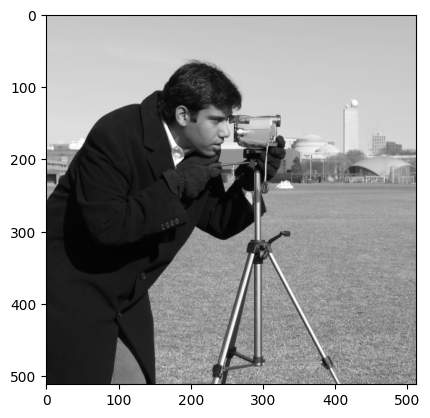

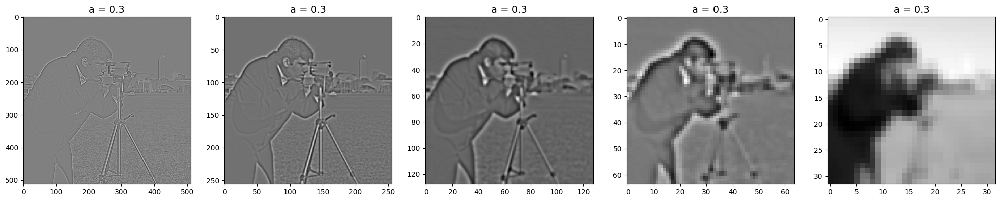

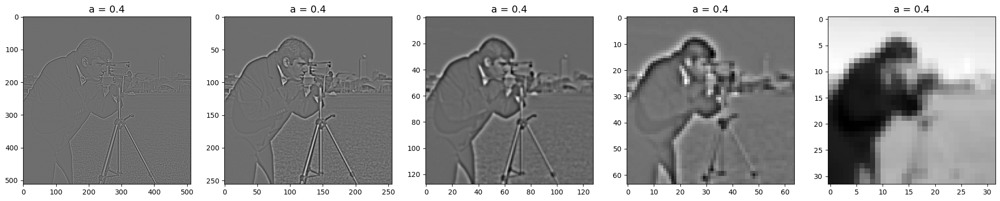

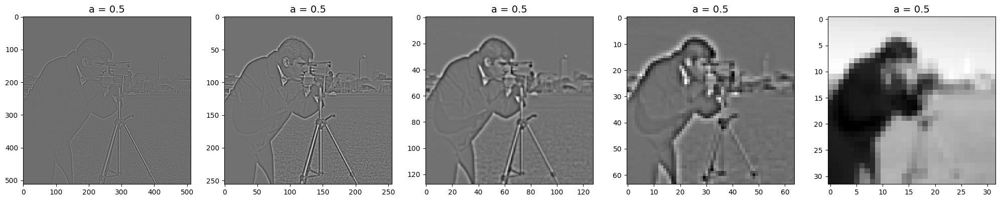

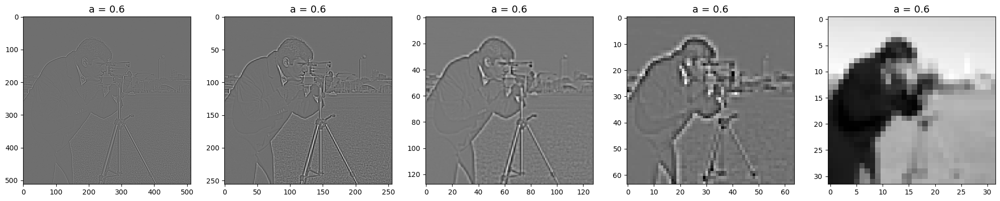

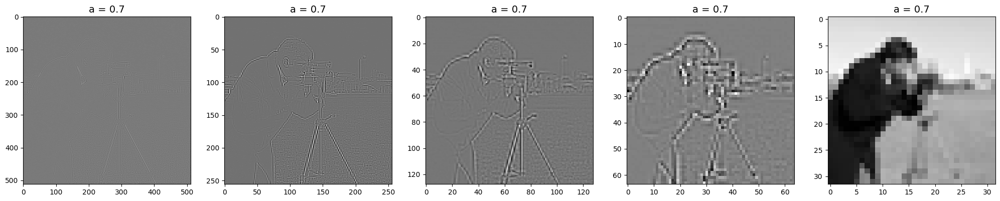

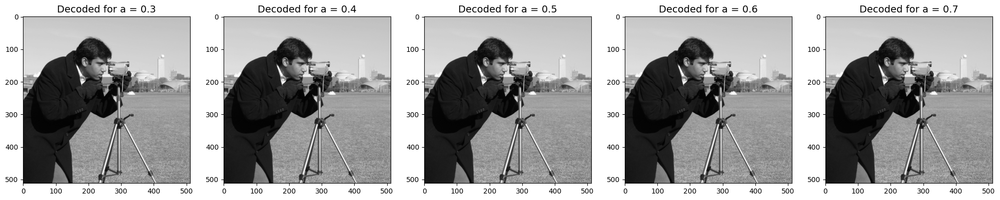

In [41]:
C_tester = []   #camera_testing = []
camera_tester_a = []    #camera_LPT_a = []
plt.imshow(camera, cmap='gray')

for i in a:
    decoded, LPT = matching_test(camera, 'gray', round(i,1), 5, 'a')
    C_tester.append(decoded)
    camera_tester_a.append(LPT)

titles = ["Decoded for a = "+str(round(i,1)) for i in a]  
print_images(C_tester, titles, 'gray')

**Σχολιασμός Αποτελεσμάτων:**

Όσο αυξάνεται η τιμή της παραμέτρου α, τόσο η εικόνα γίνεται πιο θολή στα επίπεδα τη Laplacian Pyramid και συνεπώς η αποκωδικοποιημένη εικόνα, για μικρές τιμές του α, να είναι δυσδιάκριτη. Το παραπάνω είναι λογικό, καθώς το σχήμα της συνάρτησης πυρήνα h εξαρτάται από την τιμή της παραμέτρου α. Οι μεγάλες τιμές του α, θολώνουν το επίπεδο βάσης της Laplacian Pyramid L0, με αποτέλεσμα η αρχική μορφή της εικόνας να χάνεται στο γκρι φόντο. Η μεταβολή της παραμέτρου α δεν επιδρά στο οπτικό αποτέλεσμα της ποιότητας της ανακατασκευασμένης εικόνας.   


ΕΡΩΤΗΜΑ Γ

In [42]:
depth = np.arange(3,7,1)

depth = 3: Decoded and original image -> matching completely
depth = 4: Decoded and original image -> matching completely
depth = 5: Decoded and original image -> matching completely
depth = 6: Decoded and original image -> matching completely


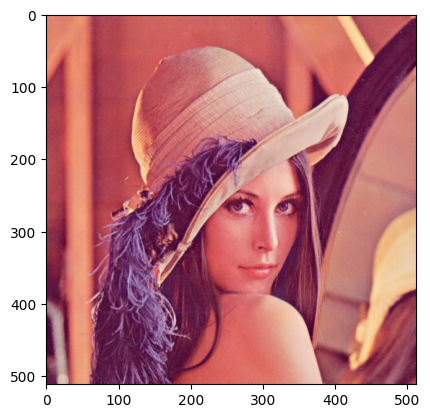

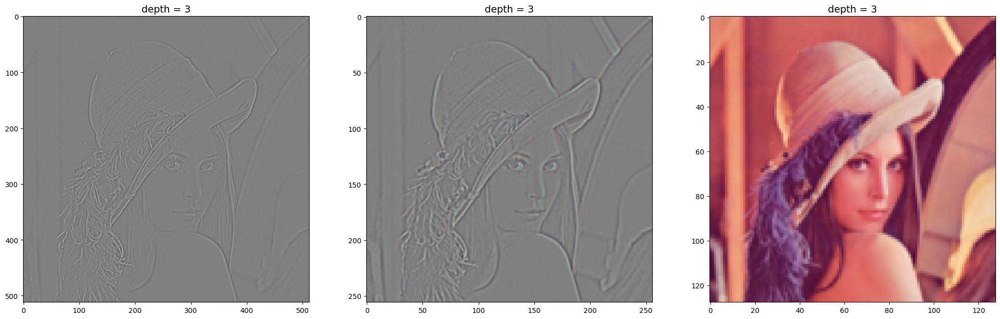

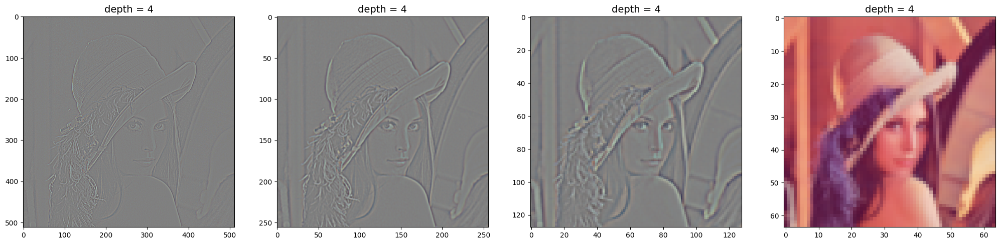

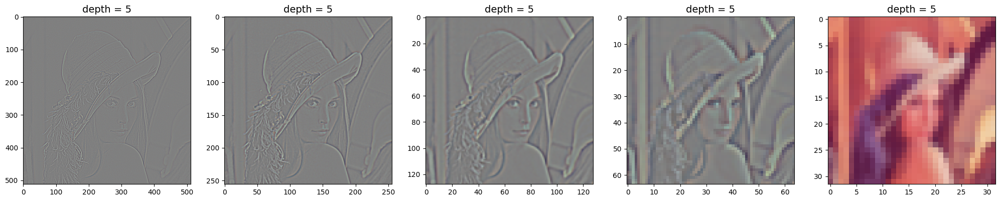

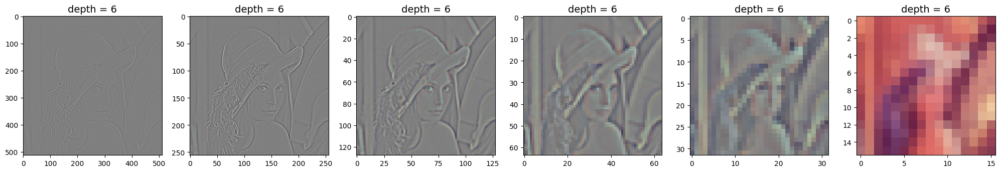

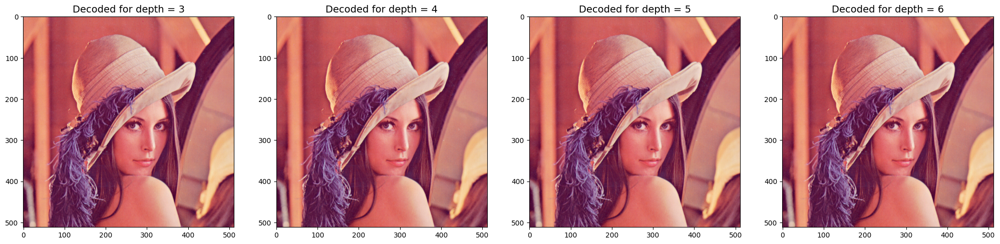

In [44]:
#c
Testing = []
Lena_depth = []
plt.imshow(Lena_RGB)

for i in depth:
    decoded, LPT = matching_test(Lena_RGB, 'color', a=0.5, depth=i, mode='depth')
    Testing.append(decoded)
    Lena_depth.append(LPT)

titles = ["Decoded for depth = "+str(round(i,1)) for i in depth]  
print_images(Testing, titles, 'color')

depth = 3: Decoded and original image -> matching completely
depth = 4: Decoded and original image -> matching completely
depth = 5: Decoded and original image -> matching completely
depth = 6: Decoded and original image -> matching completely


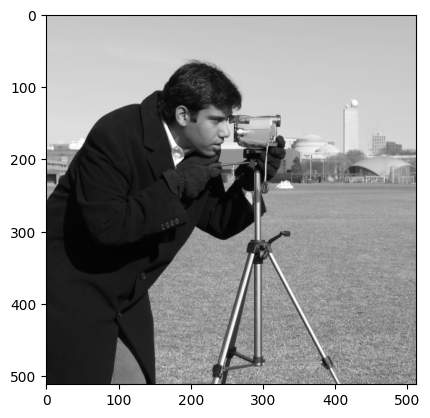

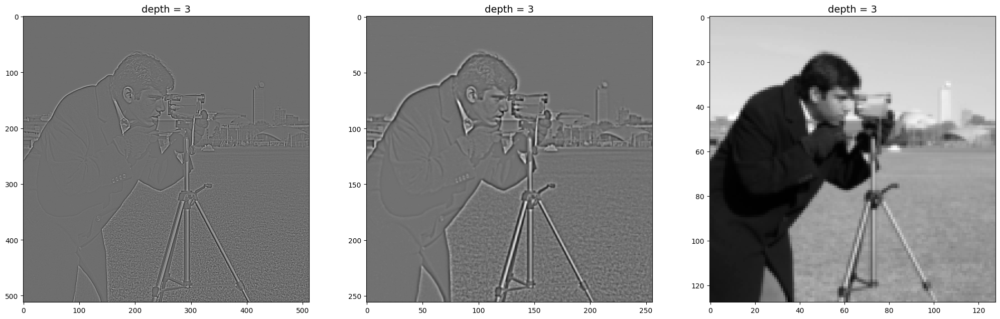

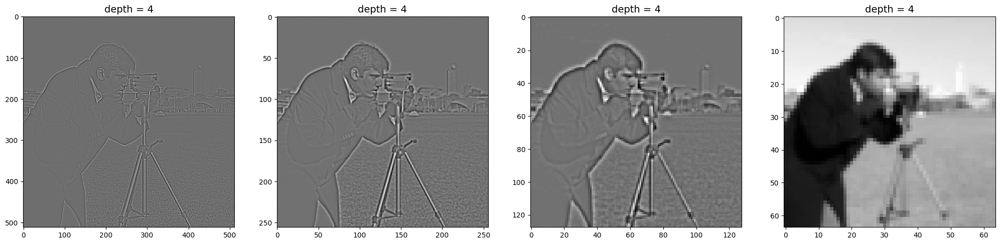

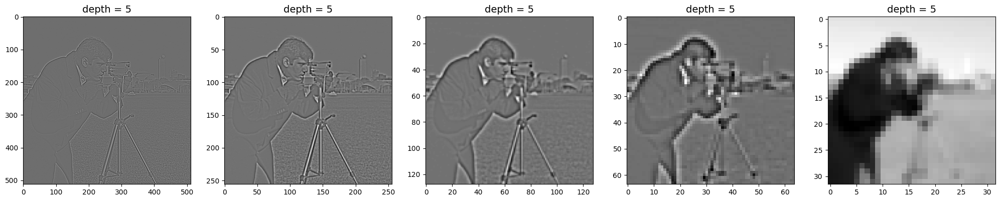

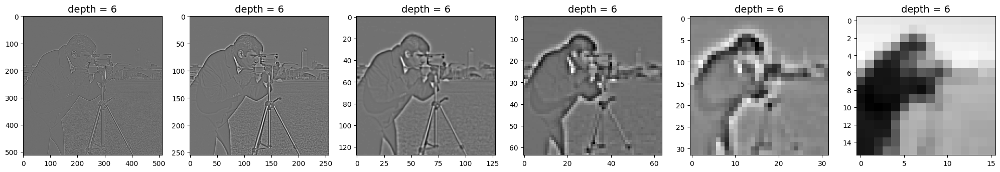

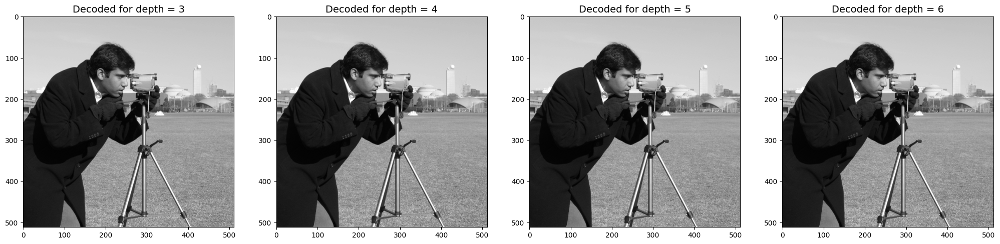

In [45]:
camera_testing = []
camera_tester_depth = []   #camera_LPT_depth = []
plt.imshow(camera, cmap='gray')

for i in depth:
    decoded, LPT = matching_test(camera, 'gray', a=0.5, depth=i, mode='depth')
    camera_testing.append(decoded)
    camera_tester_depth.append(LPT)

titles = ["Decoded for depth = "+str(round(i,1)) for i in depth]  
print_images(camera_testing, titles, 'gray')

**Σχολιασμός Αποτελεσμάτων:**

Με την αύξηση του αριθμού των επιπέδων, η εικόνα έχει χειρότερο οπτικό αποτέλεσμα στο τελευταίο επίπεδο. Αυτό είναι λογικό, καθώς, για μικρότερο αριθμό επιπέδων, η κορυφή της πυραμίδας κωδικοποιεί περισσότερη πληροφορία με μεγαλύτερη μέγιστη συχνότητα από την κορυφή μίας πυραμίδας περισσότερων επιπέδων και συνεπώς η εικόνα έχει περισσότερη λεπτομέρεια. Επίσης, με την αύξηση του αριθμού επιπέδων, η εικόνα χωρίζεται σε περισσότερα ζωνοπερατά τμήματα λεπτομέρειας, αλλά δεν επηρεάζει το τελικό αποτέλεσμα της αποκωδικοποιημένης εικόνας, η οποία ταυτίζεται με την αρχική. Το μόνο που αλλάζει κατά την αύξηση των επιπέδων είναι το φάσμα (δηλαδή πόσες υψηλές συχνότητες περιέχει) της κορυφής της Laplacian Pyramid, καθώς τόσο περισσότερα βαθυπερατά φιλτραρίσματα έχουν προηγηθεί. 

ΕΡΩΤΗΜΑ Δ

In [46]:
#d
a = np.arange(0.3,0.8,0.1) 
def calcEntropyHist (pyramid, a, depth):
    sum_hist = np.zeros([256,1], np.float64)
    histograms = []
    for n in range(depth-1):
        hist = cv2.calcHist([pyramid[n]], [0], None, [256], [0, 256])
        sum_hist += hist 
    entropy = st.entropy(sum_hist, base=2)[0]
    
    return (sum_hist, entropy)

**Testing for different values of a**

In [ ]:
# For Lena Image 

In [18]:
# we have an RGB image, so we decide to make 3 different testers

Lena_R_tester = []
Lena_R_a = []
Lena_R_histograms = []
entropies_R = []

for i in a:
    LPT = LPyramid(Lena_R, round(i,1), 5)
    decoded = L_Pyramid_Decode(LPT, round(i,1))
    Lena_R_tester.append(decoded)
    Lena_R_a.append(LPT)

for i in range(len(a)):
    histograms, entropy = calcEntropyHist(Lena_R_a[i], a[i], depth=5)
    Lena_R_histograms.append(histograms)
    entropies_R.append(entropy)

###########################

Lena_G_tester = []
Lena_G_a = []
Lena_G_histograms = []
entropies_G = []

for i in a:
    LPT = LPyramid(Lena_G, round(i,1), 5)
    decoded = L_Pyramid_Decode(LPT, round(i,1))
    Lena_G_tester.append(decoded)
    Lena_G_a.append(LPT)


for i in range(len(a)):
   histograms, entropy = calcEntropyHist(Lena_G_a[i], a[i], depth=5)
   Lena_G_histograms.append(histograms)
   entropies_G.append(entropy)

############################

Lena_B_tester = []
Lena_B_a = []
Lena_B_histograms = []
entropies_B = []

for i in a:
    LPT = LPyramid(Lena_B, round(i,1), 5)
    decoded = L_Pyramid_Decode(LPT, round(i,1))
    Lena_B_tester.append(decoded)
    Lena_B_a.append(LPT)

for i in range(len(a)):
   histograms, entropy = calcEntropyHist(Lena_B_a[i], a[i], depth=5)
   Lena_B_histograms.append(histograms)
   entropies_B.append(entropy)

In [ ]:
#############################

a = 0.3: Lena entropy = 4.88703596107597

a = 0.4: Lena entropy = 4.758526993220464

a = 0.5: Lena entropy = 4.59156720888356

a = 0.6: Lena entropy = 4.3951474669730475

a = 0.7: Lena entropy = 4.269753650571352



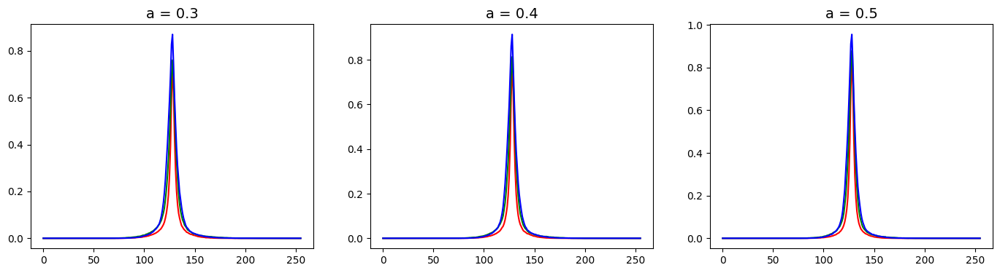

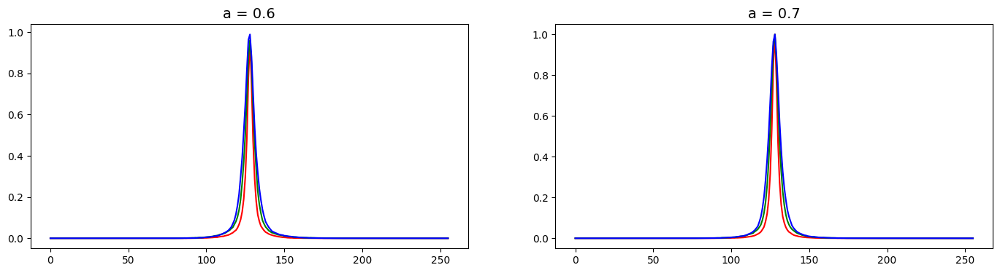

In [19]:
# Lena

Lena_R_histograms = Lena_R_histograms/np.max(Lena_R_histograms)
Lena_G_histograms = Lena_G_histograms/np.max(Lena_G_histograms)
Lena_B_histograms = Lena_B_histograms/np.max(Lena_B_histograms)
titles = ['a = '+str(round(i,1)) for i in a]

ax = np.zeros(len(a))
f, ax = plt.subplots(1, 3, figsize=(17, 4))

for i in range(3):
    ax[i].plot(Lena_R_histograms[i], color='r')
    ax[i].plot(Lena_G_histograms[i], color='g')
    ax[i].plot(Lena_B_histograms[i], color='b')
    ax[i].set_title(titles[i], fontsize=14)

f, ax = plt.subplots(1, 2, figsize=(17, 4))
for i in range(2):
    ax[i].plot(Lena_R_histograms[i+3], color='r')
    ax[i].plot(Lena_G_histograms[i+3], color='g')
    ax[i].plot(Lena_B_histograms[i+3], color='b')
    ax[i].set_title(titles[i+3], fontsize=14)

Lena_ent_a_plots = []
for i in range(len(a)):
    ent = (entropies_R[i] + entropies_G[i] + entropies_B[i])/3
    Lena_ent_a_plots.append(ent)
    print('a = '+ str(round(a[i],1)) + ': '+ 'Lena entropy = '+str(ent)+'\n')

a = 0.3: camera entropy = 4.613982109822043

a = 0.4: camera entropy = 4.510065974811689

a = 0.5: camera entropy = 4.367103058261302

a = 0.6: camera entropy = 4.216512156354405

a = 0.7: camera entropy = 4.140811520804269



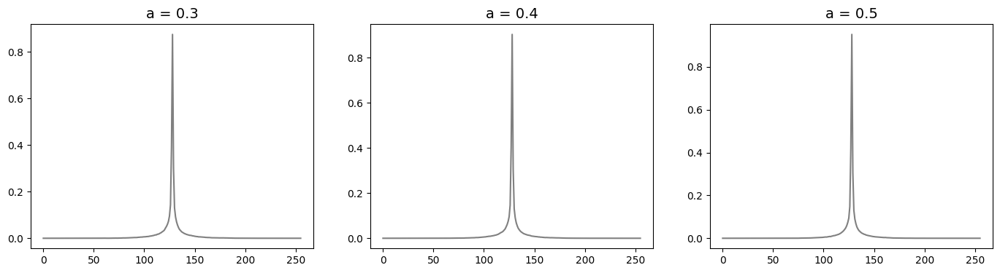

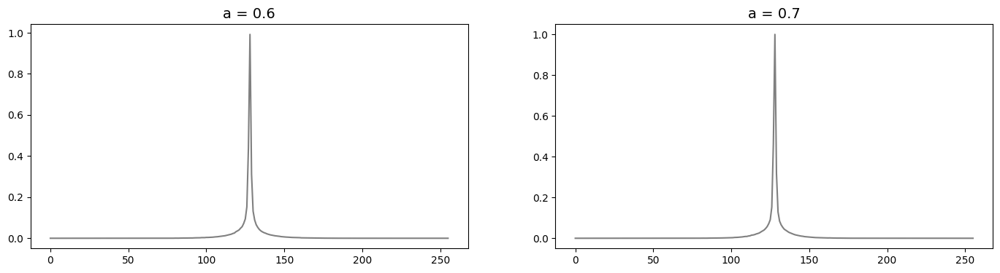

In [20]:
# camera

camera_histograms = []
entropies_camera = []
for i in range(len(a)):
    histograms, entropy = calcEntropyHist(camera_tester_a[i], a[i], depth=5)
    camera_histograms.append(histograms)
    entropies_camera.append(entropy)
    
camera_histograms = camera_histograms/np.max(camera_histograms)
titles = ['a = '+str(round(i,1)) for i in a]

ax = np.zeros(len(a))
f, ax = plt.subplots(1, 3, figsize=(17, 4))
for i in range(3):
    ax[i].plot(camera_histograms[i], color='gray')
    ax[i].set_title(titles[i], fontsize=14)
    
f, ax = plt.subplots(1, 2, figsize=(17, 4))
for i in range(2):
    ax[i].plot(camera_histograms[i+3], color='gray')
    ax[i].set_title(titles[i+3], fontsize=14)


for i in range(len(a)):
    print('a = '+ str(round(a[i],1)) + ': '+ 'camera entropy = ' +str(entropies_camera[i])+'\n')

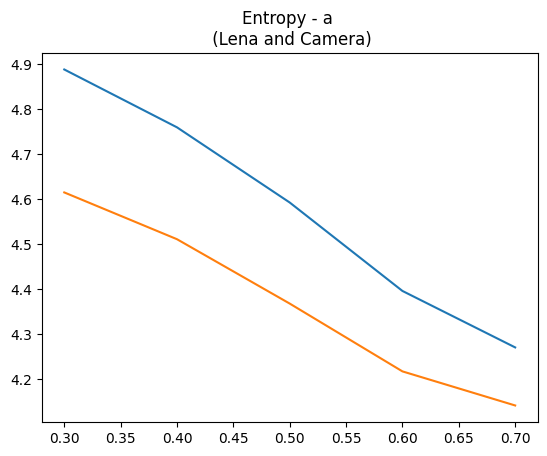

In [21]:
plt.figure()
plt.plot(a, Lena_ent_a_plots)
plt.plot(a, entropies_camera)
_=plt.title("Entropy - a \n (Lena and Camera)")

**Testing for different values of depth**

In [ ]:
# For Lena Image

In [22]:
R_testing = []
Lena_R_depth = []
for i in depth:
    #decoded, LPT = matching_test(Lena_R, 'R', a=0.5, depth=i, mode='depth')
    LPT = LPyramid(Lena_R, 0.5, i)
    decoded = L_Pyramid_Decode(LPT, 0.5)
    R_testing.append(decoded)
    Lena_R_depth.append(LPT)

# Lena Channel R
Lena_R_histograms = []
entropies_R = []
for i in range(len(depth)):
    histograms, entropy = calcEntropyHist(Lena_R_depth[i], a=0.5, depth=depth[i])
    Lena_R_histograms.append(histograms)
    entropies_R.append(entropy)


G_testing = []
Lena_G_depth = []
for i in depth:
    #decoded, LPT = matching_test(Lena_G, 'G', a=0.5, depth=i, mode='depth')
    LPT = LPyramid(Lena_G, 0.5, i)
    decoded = L_Pyramid_Decode(LPT, 0.5)
    G_testing.append(decoded)
    Lena_G_depth.append(LPT)

# Lena Channel G
Lena_G_histograms = []
entropies_G = []
for i in range(len(depth)):
    histograms, entropy = calcEntropyHist(Lena_G_depth[i], a=0.5, depth=depth[i])
    Lena_G_histograms.append(histograms)
    entropies_G.append(entropy)

B_testing = []
Lena_B_depth = []
for i in depth:
    #decoded, LPT = matching_test(Lena_B, 'B', a=0.5, depth=i, mode='depth')
    LPT = LPyramid(Lena_B, 0.5, i)
    decoded = L_Pyramid_Decode(LPT, 0.5)
    B_testing.append(decoded)
    Lena_B_depth.append(LPT)

# Lena Channel B
Lena_B_histograms = []
entropies_B = []
for i in range(len(depth)):
    histograms, entropy = calcEntropyHist(Lena_B_depth[i], a=0.5, depth=depth[i])
    Lena_B_histograms.append(histograms)
    entropies_B.append(entropy)

depth = 3: lena entropy = 4.55563532511707

depth = 4: lena entropy = 4.577164976083847

depth = 5: lena entropy = 4.59156720888356

depth = 6: lena entropy = 4.597661897659877



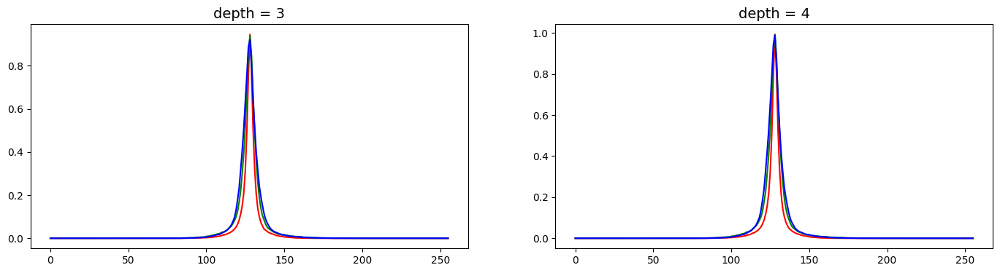

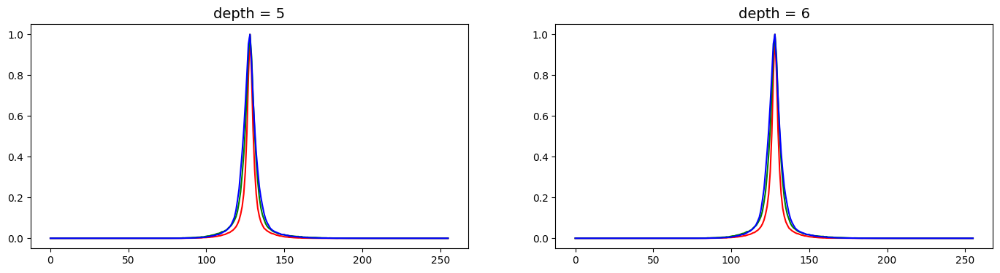

In [23]:
Lena_R_histograms = Lena_R_histograms/np.max(Lena_R_histograms)
Lena_G_histograms = Lena_G_histograms/np.max(Lena_G_histograms)
Lena_B_histograms = Lena_B_histograms/np.max(Lena_B_histograms)
titles = ['depth = '+str(round(i,1)) for i in depth]

ax = np.zeros(len(depth))
f, ax = plt.subplots(1, 2, figsize=(17, 4))
for i in range(2):
    ax[i].plot(Lena_R_histograms[i], color='r')
    ax[i].plot(Lena_G_histograms[i], color='g')
    ax[i].plot(Lena_B_histograms[i], color='b')
    ax[i].set_title(titles[i], fontsize=14)
    
f, ax = plt.subplots(1, 2, figsize=(17, 4))
for i in range(2):
    ax[i].plot(Lena_R_histograms[i+2], color='r')
    ax[i].plot(Lena_G_histograms[i+2], color='g')
    ax[i].plot(Lena_B_histograms[i+2], color='b')
    ax[i].set_title(titles[i+2], fontsize=14)


Lena_ent_depth_plots = []
for i in range(len(depth)):
    ent = (entropies_R[i] + entropies_G[i] + entropies_B[i])/3
    Lena_ent_depth_plots.append(ent)
    print('depth = '+ str(round(depth[i],1)) + ': '+'lena entropy = '+ str(ent)+'\n')

In [ ]:
# For Camera Image

In [24]:
camera_histograms = []
entropies_camera = []
for i in range(len(depth)):
    histograms, entropy = calcEntropyHist(camera_tester_depth[i], a=0.5, depth=depth[i])
    camera_histograms.append(histograms)
    entropies_camera.append(entropy)

depth = 3: camera entropy 4.359913027251088

depth = 4: camera entropy 4.362569133462733

depth = 5: camera entropy 4.367103058261302

depth = 6: camera entropy 4.37032460174544



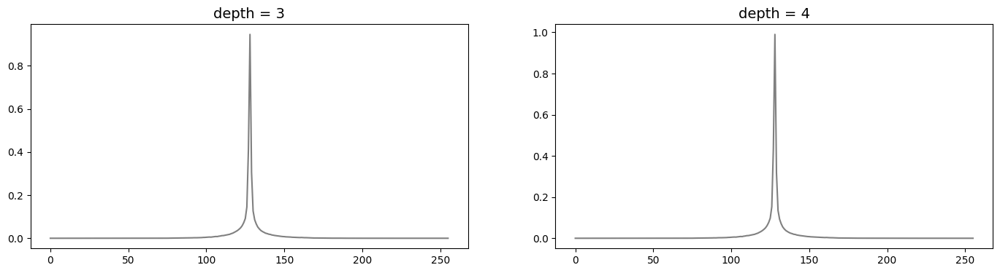

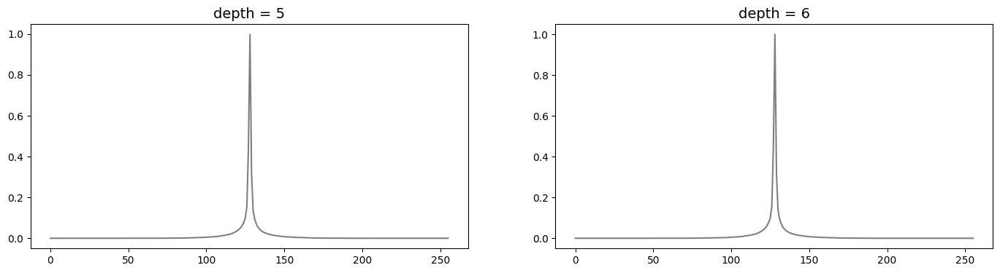

In [25]:
camera_histograms = camera_histograms/np.max(camera_histograms)
titles = ['depth = '+str(round(i,1)) for i in depth]

ax = np.zeros(len(depth))
f, ax = plt.subplots(1, 2, figsize=(17, 4))
for i in range(2):
    ax[i].plot(camera_histograms[i], color='gray')
    ax[i].set_title(titles[i], fontsize=14)
    
f, ax = plt.subplots(1, 2, figsize=(17, 4))
for i in range(2):
    ax[i].plot(camera_histograms[i+2], color='gray')
    ax[i].set_title(titles[i+2], fontsize=14)

for i in range(len(depth)):
    print('depth = '+ str(round(depth[i],1)) + ': '+ 'camera entropy ' +str(entropies_camera[i])+'\n')

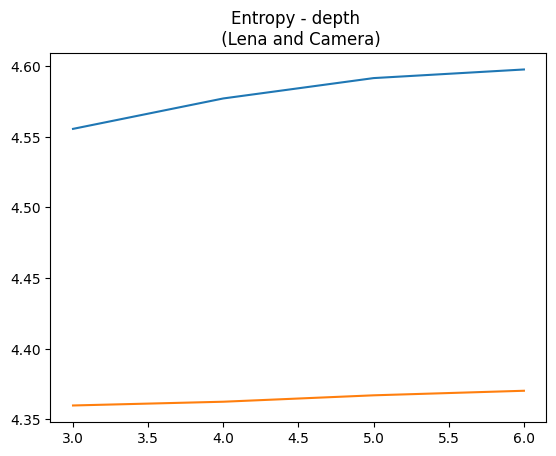

In [47]:
plt.figure()
plt.plot(depth, Lena_ent_depth_plots)
plt.plot(depth, entropies_camera)
_=plt.title("Entropy - depth \n (Lena and Camera)")

**Σχολιασμός Αποτελεσμάτων:**

Καθώς αυξάνεται η τιμή της παραμέτρου α, η εντροπία της εικόνας μειώνεται και το αντίστοιχο ιστόγραμμα κατανομής τιμών των pixel "στενεύει" όλο και πιο πολύ, γεγονός που υποδηλώνει την κωδικοποίηση σε λιγότερα bits.

Καθώς αυξάνονται τα επίπεδα έχει η Laplacian Pyramid, τόσο μεγαλύτερη γίνεται η τιμή της εντροπίας και τόσο πιο "διευρυμένο" είναι το ιστόγραμμα τιμών.  

ΕΡΩΤΗΜΑ Ε

In [27]:
#e

def calc_histogram(Pyramid,a,depth): 
  histograms = []
  for c in range(len(Pyramid)):
    sum_histogram = np.zeros([256,1], np.float64)
    aux = []
    for n in range(depth):
      hist = cv2.calcHist([Pyramid[c][n]], [0], None, [256], [0, 256])
      sum_histogram += hist
      aux.append(hist)
    aux.append(sum_histogram)
    histograms.append(aux)
  return histograms

def question_e(I):
    histograms = []
    f,ax = plt.subplots(1,1,figsize = (5,5)) 
    x = []

    for i in range(2,8):
      entr_a = []
      entr = 0
      a = i/10
      x.append(a)
      I_out_Pyramid = LPyramid(I,a,5)
      if len(I_out_Pyramid[0].shape) == 3:
        r = []
        g = []
        b = []
        for i in I_out_Pyramid:
          r.append(i[:,:,0])
          g.append(i[:,:,1])
          b.append(i[:,:,2])
        I_out_Pyramid = [r,g,b]
      else:
        r = []
        for i in I_out_Pyramid:
          r.append(i[:,:])
        I_out_Pyramid = r
      histograms.append(calc_histogram (I_out_Pyramid,a,5))

    for depth in range(0,5):
      ent_d = []
      for a in range(0,6):
        entr = 0
        for c in range(len(I_out_Pyramid)):
          entr += sp_ent(histograms[a][c][depth],base = 2)[0]
        ent_d.append(entr/len(I_out_Pyramid))
      ax.set_title("Entropy for Different Layers")
      ax.plot(x,ent_d,'-p',label=f"Layer {5-depth-1}")
      ax.legend()

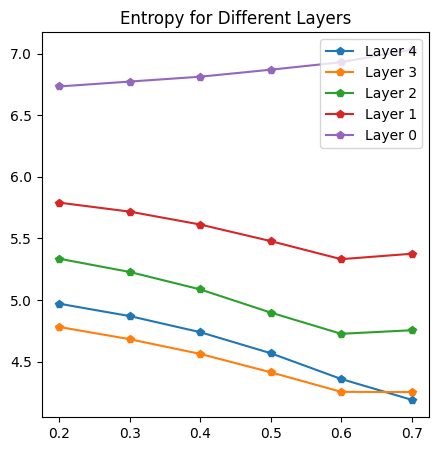

In [28]:
question_e(Lena_RGB)

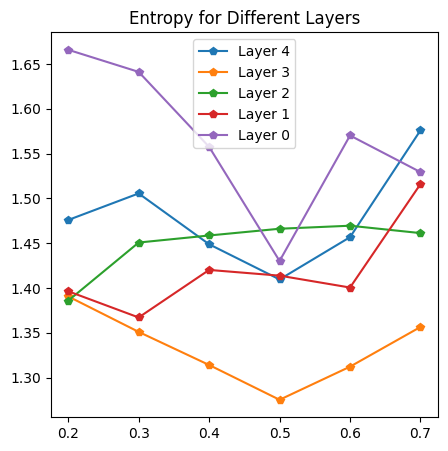

In [29]:
question_e(camera)

**Σχολιασμός Αποτελεσμάτων:**



Παρατηρούμε ότι η ελάχιστη εντροπία των περισσότερων επιπέδων βρίσκεται ανάμεσα στο 0.5 και στο 0.6. Αν θεωρήσουμε ότι α=0.6, τότε η εντροπία κάθε επιπέδου είναι η ελάχιστη ή είναι πολύ κοντά στην ελάχιστη. Συνεπώς, συνδυάζοντας τις παρατηρήσεις του άρθρου καθώς και τα αποτελέσματα των γραφημάτων, συμπεραίνουμε ότι το βέλτιστο α ισούται με 0.6.

ΕΡΩΤΗΜΑ ΣΤ

In [30]:
#st
# aux function
def quantize_I(I,b):
  bins = np.linspace(0,255,b)
  Q = np.digitize(I,bins) + 255//(2*b)
  return Q.astype(np.uint8)

In [31]:
def Aux_L_Quantization(I,a,depth,bins):
  L = LPyramid(I,a,depth)
  # L = split_channels(L)
  Pyramid = []
  for Im in L:
    # C=[]
    #print(Im)
    Pyramid.append(quantize_I(Im,bins[i]))
    # Pyramid.append(C)
  return L_Pyramid_Decode(Pyramid,a), Pyramid


In [32]:
def question_st(I,bins):
  if(len(I.shape)==3):
    cmap = 'viridis'
  else:
    cmap = 'gray'
  # print(bins)
  Quantized, Pyramid = Aux_L_Quantization(I,0.6,5,bins)
  entr = 0
  
  sum_histogram = calc_histogram(Pyramid,0.6,5)
  Colors = len(Pyramid)
  for c in range(Colors):
    entr += sp_ent(sum_histogram[c][-1],base = 2)[0]
  entr /= len(Pyramid)

  f,ax = plt.subplots(1,2,figsize=(8,8))
  ax[0].imshow(I, cmap = cmap)
  ax[1].imshow(Quantized, cmap = cmap)
  ax[0].set_title("Original Image ")
  ax[1].set_title("Decoded Image ")

  plt.show()
  
  print("Entropy: ", entr)

  if(I == Quantized).all():
    print("The Images are equal\n")
  else: 
    print("The Images do not match\n")


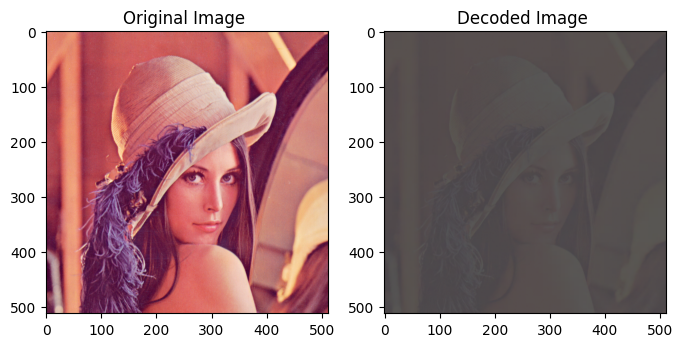

Entropy:  1.073333755047809
The Images do not match



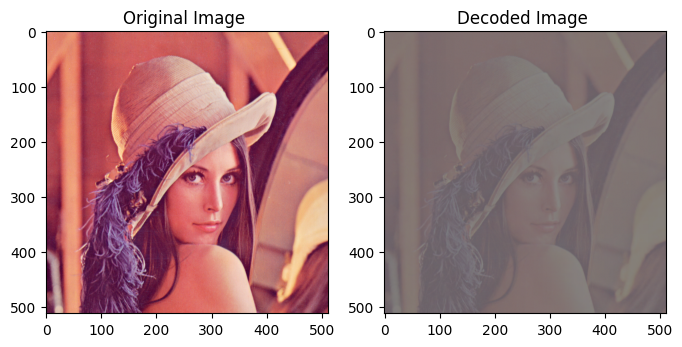

Entropy:  1.8079328997647999
The Images do not match



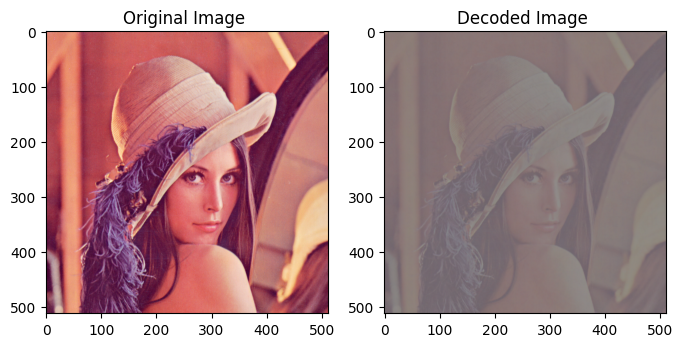

Entropy:  2.1185624509112144
The Images do not match



In [33]:
question_st(Lena_RGB,[5,10,15,20,25])
question_st(Lena_RGB,[10,20,30,40,50])
question_st(Lena_RGB,[30,35,40,45,50])

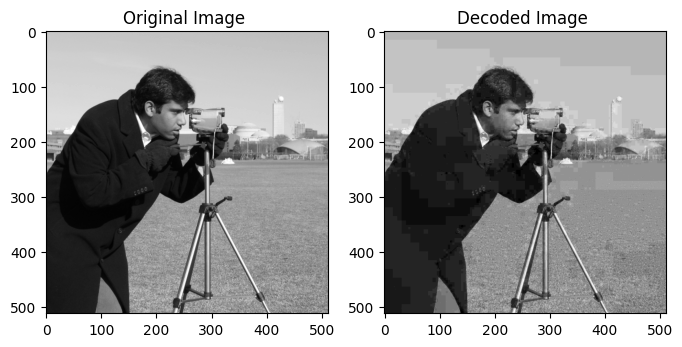

Entropy:  0.22780126197184747
The Images do not match



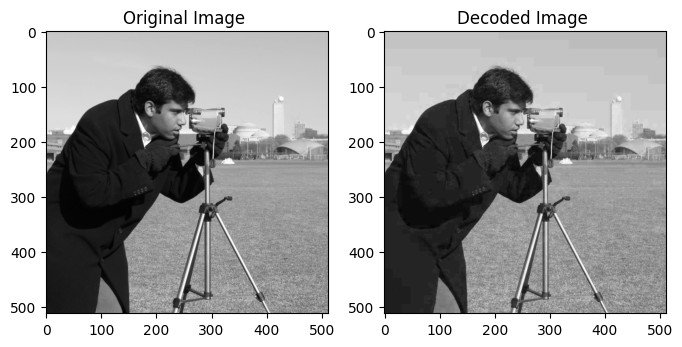

Entropy:  0.34879016361335186
The Images do not match



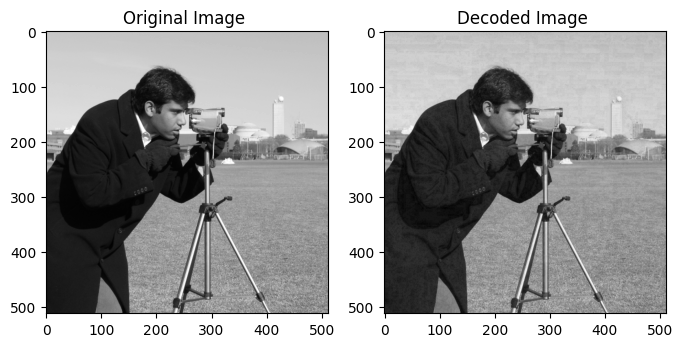

Entropy:  1.0452257930626054
The Images do not match



In [34]:
question_st(camera,[5,10,15,20,25])
question_st(camera,[10,20,30,40,50])
question_st(camera,[30,35,40,45,50])

**Σχολιασμός Αποτελεσμάτων:**

Παρατηρούμε ότι οι αποκωδικοποιημένες εικόνες δεν ταυτίζονται με την αρχική. Ωστόσο, είναι αρκετά κοντά σε αυτήν και αυτό φαίνεται πιο εύκολα στην ασπρόμαυρη εικόνα με την κάμερα (αν καλέσουμε την συνάρτηση ξεχωριστά για κάθε διαφορετικό επίπεδο χρώματος της εικόνας Lena -όπως φαίνεται παρακάτω- παρατηρούμε και εδώ ότι υπαρχει κάποια ομοιότητα με την αρχική).
Παρατηρούμε, επίσης, ότι η κβάντιση της πυραμίδας με μικρό αριθμό bins συνεπάγεται αισθητή μείωση της εντροπίας της κβαντισμένης πυραμίδας σε σχέση με αυτήν της μη κβαντισμένης.